In [1]:
%load_ext autoreload

%autoreload 2

In [2]:
import math
from sklearn.metrics import classification_report
import matplotlib.pyplot as plt
from matplotlib.pyplot import imshow, imread, imsave, figure
import pandas as pd
import numpy as np
import os
import sys
from skimage.color import rgb2gray
from skimage.transform import rescale, resize
import seaborn as sns

#Keras:
import keras
from keras.preprocessing.image import ImageDataGenerator
from keras.callbacks import LearningRateScheduler
from keras.optimizers import SGD
from keras.models import *
from keras.layers import *
from keras.optimizers import *
from keras.callbacks import ModelCheckpoint, LearningRateScheduler

#Custom Functions:
ROOT_DIR = os.path.abspath("../")
sys.path.append(ROOT_DIR)

from utils.log_progress import *
from utils.tools import *
from utils.config import *
from utils.utils import *

from unet.unet import *
from unet.data_generator import *
from unet.losses import *

from keras.models import load_model, model_from_json

Using TensorFlow backend.


In [6]:
import warnings
warnings.filterwarnings("ignore")

In [4]:
from keras import backend as K
K.tensorflow_backend._get_available_gpus()

[]

### load Model:

In [7]:
model = load_model('../saved_models/model0/model0.h5', custom_objects={'bce_dice_loss': bce_dice_loss,'dice_coeff':dice_coeff,'iou_score':iou_score})

# 1. Visual Results (on Test Set)

### 2.1 Show Samples of trained Model:

In [10]:
train80_df = pd.read_pickle(Config.DATA_BASE_PATH+'/train_df')
val20_df = pd.read_pickle(Config.DATA_BASE_PATH+'/val_df')

print("Number of training Samples:", len(train80_df))
print("Number of validation Samples:", len(val20_df))

Number of training Samples: 405
Number of validation Samples: 102


In [11]:
train20_df = train80_df[0:102]
val80_df = val20_df.append(train80_df[102::])
print("Number of training Samples:", len(train20_df))
print("Number of validation Samples:", len(val80_df))

Number of training Samples: 102
Number of validation Samples: 405


#### Leaf Segmentation:

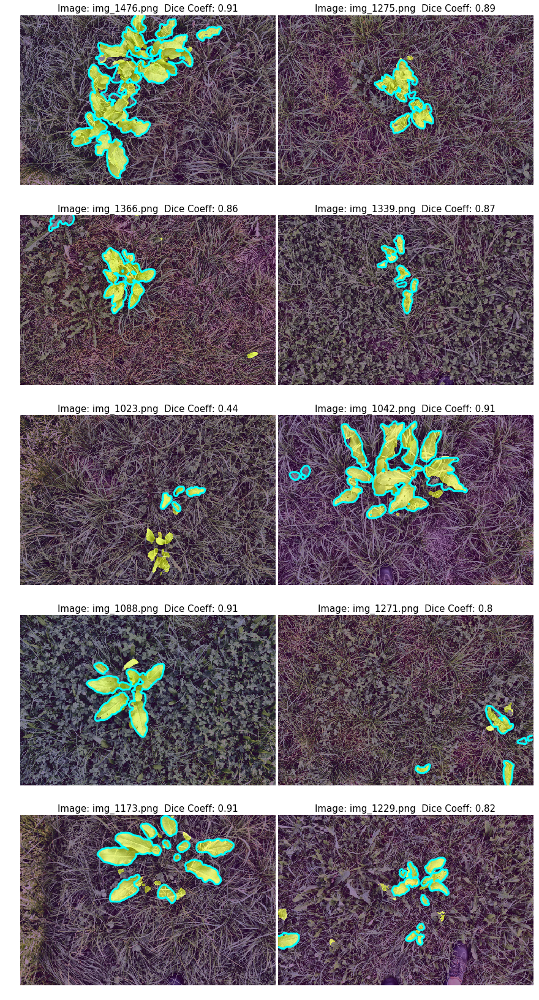

In [8]:
vis_params = {'df':val20_df,
              'input_shape':(512,768,3),
              'predictiontype':'leaf',
              'model':model}

vis = Visualize(**vis_params)
vis.show_matrix("random","image_prediction_contour",rows=5)

#### Root Detection:

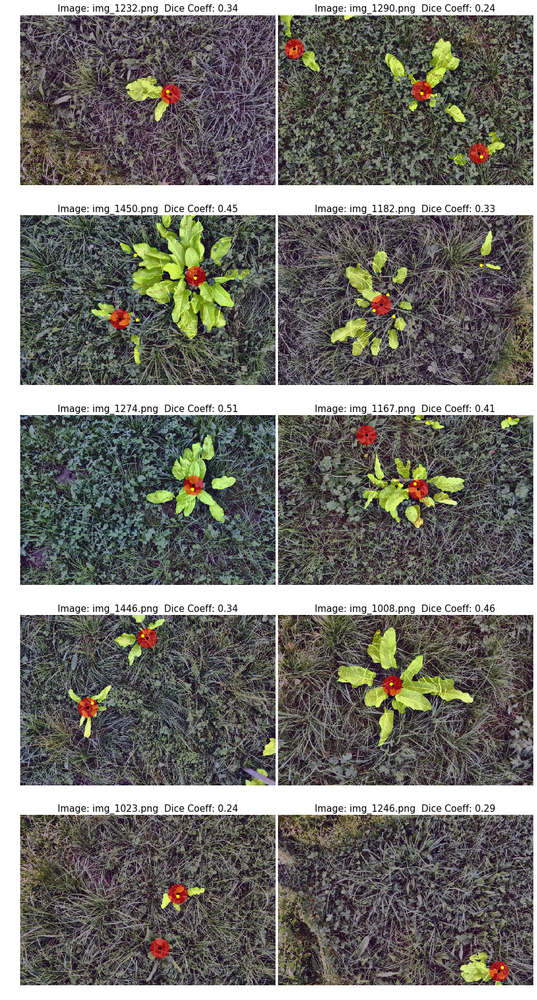

In [18]:
vis_params = {'df':val20_df,
              'input_shape':(512,768,3),
              'masktype':'leaf',
              'predictiontype':'root',
              'model':model}

vis = Visualize(**vis_params)
vis.show_matrix("random","image_prediction_roots",rows=5)

### Test Set with new field images:

#### Leaf Segmentation:

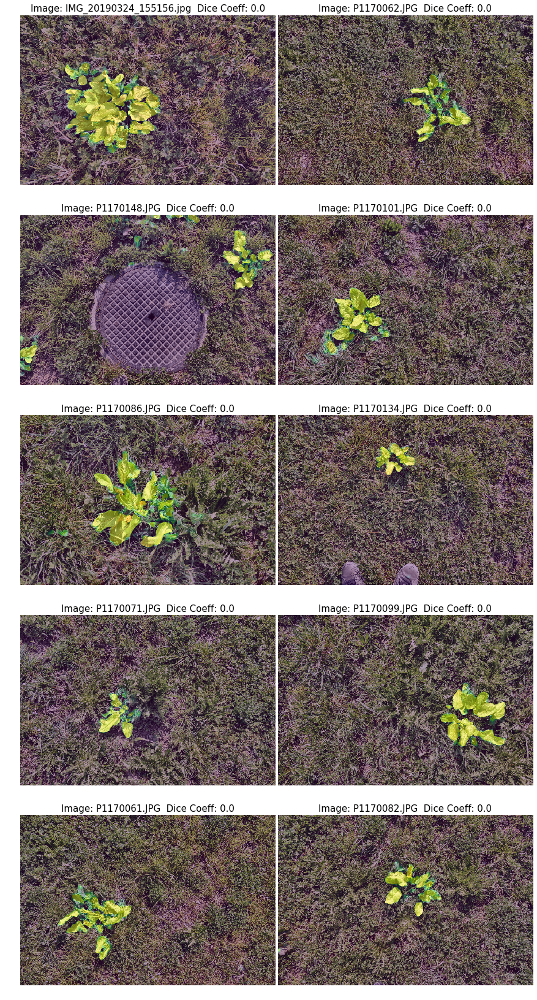

In [22]:
imgs = os.listdir(Config.DATA_BASE_PATH+"/02_test/images")
files = {"image_path":Config.DATA_BASE_PATH+"/02_test/images/",
         "name":imgs}
test_field_df = pd.DataFrame.from_dict(files)

vis_params = {'df':test_field_df,
              'input_shape':(512,768,3),
              'predictiontype':'leaf',
              'model':model}

vis = Visualize(**vis_params)
vis.show_matrix("random","image_prediction",rows=5)

#### Root Detection:

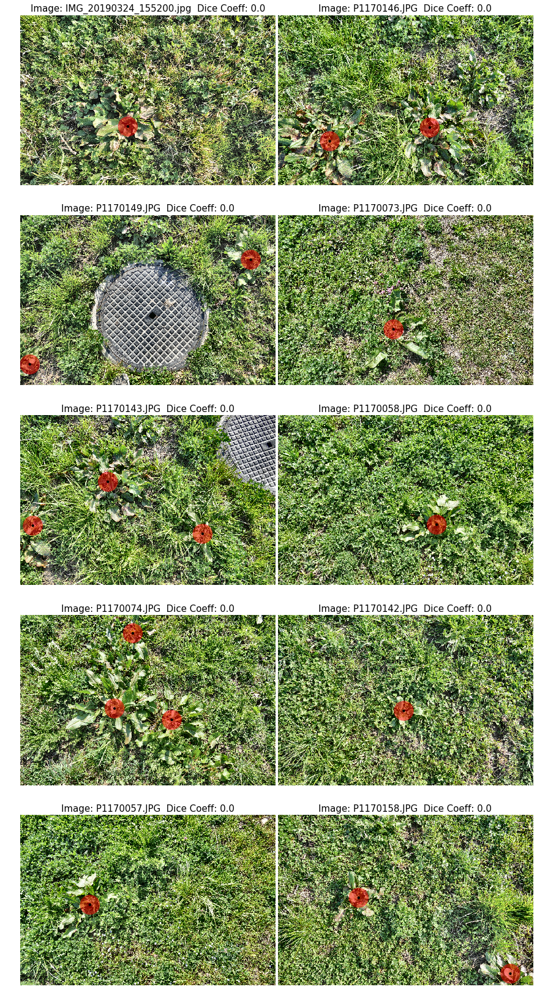

In [24]:
imgs = os.listdir(Config.DATA_BASE_PATH+"/02_test/images")
files = {"image_path":Config.DATA_BASE_PATH+"/02_test/images/",
         "name":imgs}
test_field_df = pd.DataFrame.from_dict(files)

vis_params = {'df':test_field_df,
              'input_shape':(512,768,3),
              'predictiontype':'root',
              'model':model}

vis = Visualize(**vis_params)
vis.show_matrix("random","image_prediction_roots",rows=5)

### New Testset
Testphotos von Wiese vor Büro

In [25]:
imgs = os.listdir(Config.DATA_BASE_PATH+"/02_test/images")
files = {"image_path":Config.DATA_BASE_PATH+"/02_test/images/",
         "name":imgs}
test_field_df = pd.DataFrame.from_dict(files)
test_field_df.sample(2)

,image_path,name
17,../data/02_test/images/,P1170114.JPG
29,../data/02_test/images/,P1170064.JPG


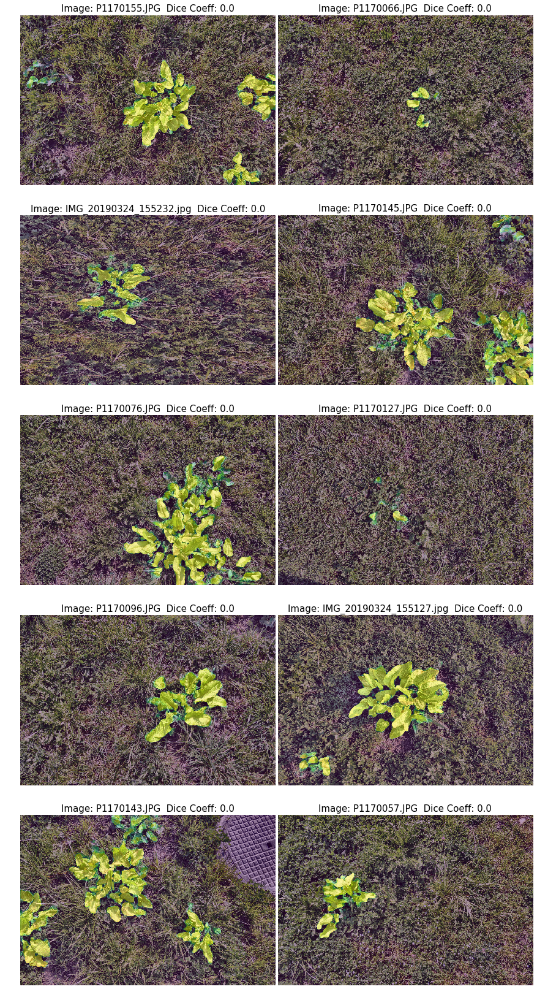

In [27]:
vis_params = {'df':test_field_df,
              'input_shape':(512,768,3),
              'predictiontype':'leaf',
              'model':model}

visualize = Visualize(**vis_params)
visualize.show_matrix("random",mode="image_prediction",rows=5)

# 2. Measured Results (on Test Set)

### Leaf Segmentation

#### Model0:

In [25]:
model = load_model('../saved_models/model0/model0.h5', custom_objects={'bce_dice_loss': bce_dice_loss,'dice_coeff':dice_coeff,'iou_score':iou_score})

In [26]:
ev_params = {'df':val20_df,
             'input_shape':(512,768,3),
             'predictiontype':'leaf',
             'masktype' : 'leaf',
             'model':model}
ev = Evaluate(**ev_params)

model0_DCs, model0_TPs, model0_FPs, model0_FNs, model0_names = ev.get_seg_eval_metrics()

In [27]:
print("Average Dice Coefficient: " + str(np.mean(model0_DCs)))
print("STD Dice Coefficient: " + str(np.std(model0_DCs)))
print("Average TPs: " + str(np.mean(model0_TPs)))
print("STD TPs: " + str(np.std(model0_TPs)))
print("Average FPs: " + str(np.mean(model0_FPs)))
print("STD FPs: " + str(np.std(model0_FPs)))
print("Average FNs: " + str(np.mean(model0_FNs)))
print("STD FNs: " + str(np.std(model0_FNs)))

Average Dice Coefficient: 0.8391175500133216
STD Dice Coefficient: 0.14667506123625013
Average TPs: 0.9864484250935075
STD TPs: 0.012047486111020083
Average FPs: 0.005062576992059844
STD FPs: 0.006850762258016703
Average FNs: 0.06862745098039216
STD FNs: 0.25281954820054175


(0, 1.0)

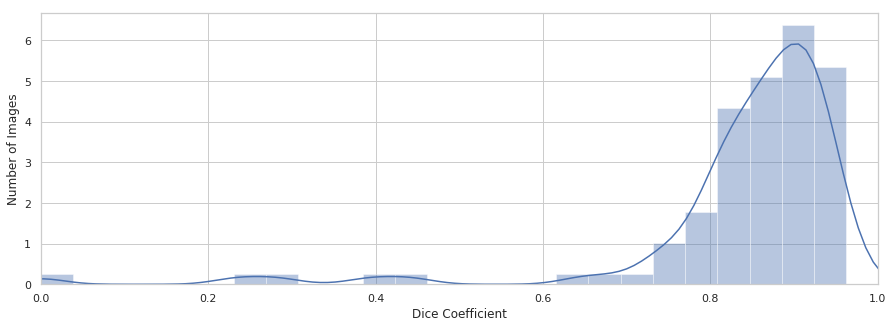

In [60]:
sns.set(style="whitegrid")
plt.figure(figsize=(15,5))
ax = sns.distplot(model0_DCs)
ax.set(xlabel='Dice Coefficient', ylabel='Number of Images')
ax.set_xlim(0, 1.0)

#### Model0b:

In [25]:
model = load_model('../saved_models/model0b/model0b.h5', custom_objects={'bce_dice_loss': bce_dice_loss,'dice_coeff':dice_coeff,'iou_score':iou_score})

In [26]:
ev_params = {'df':val20_df,
             'input_shape':(512,768,3),
             'predictiontype':'leaf',
             'masktype' : 'leaf',
             'model':model}
ev = Evaluate(**ev_params)

model0b_DCs, model0b_TPs, model0b_FPs, model0b_FNs, model0b_names = ev.get_seg_eval_metrics()

In [63]:
print("Average Dice Coefficient: " + str(np.mean(model0b_DCs)))
print("STD Dice Coefficient: " + str(np.std(model0b_DCs)))
print("Average TPs: " + str(np.mean(model0b_TPs)))
print("STD TPs: " + str(np.std(model0b_TPs)))
print("Average FPs: " + str(np.mean(model0b_FPs)))
print("STD FPs: " + str(np.std(model0b_FPs)))
print("Average FNs: " + str(np.mean(model0b_FNs)))
print("STD FNs: " + str(np.std(model0b_FNs)))

Average Dice Coefficient: 0.8287900143637668
STD Dice Coefficient: 0.14428945290381437
Average TPs: 0.9853292976329528
STD TPs: 0.01280304152359253
Average FPs: 0.006186815648297082
STD FPs: 0.007857414363385305
Average FNs: 0.06862745098039216
STD FNs: 0.25281954820054175


(0, 1.0)

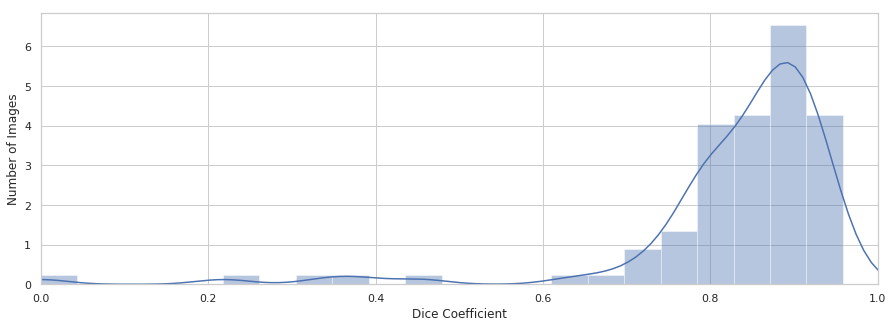

In [62]:
sns.set(style="whitegrid")
plt.figure(figsize=(15,5))
ax = sns.distplot(model0b_DCs)
ax.set(xlabel='Dice Coefficient', ylabel='Number of Images')
ax.set_xlim(0, 1.0)

#### Model1:

In [29]:
model = load_model('../saved_models/model1/model1.h5', custom_objects={'bce_dice_loss': bce_dice_loss,'dice_coeff':dice_coeff,'iou_score':iou_score})

In [30]:
ev_params = {'df':val20_df,
             'input_shape':(512,768,3),
             'predictiontype':'leaf',
             'masktype' : 'leaf',
             'model':model}
ev = Evaluate(**ev_params)

model1_DCs, model1_TPs, model1_FPs, model1_FNs, model1_names = ev.get_seg_eval_metrics()

In [31]:
print("Average Dice Coefficient: " + str(np.mean(model1_DCs)))
print("STD Dice Coefficient: " + str(np.std(model1_DCs)))
print("Average TPs: " + str(np.mean(model1_TPs)))
print("STD TPs: " + str(np.std(model1_TPs)))
print("Average FPs: " + str(np.mean(model1_FPs)))
print("STD FPs: " + str(np.std(model1_FPs)))
print("Average FNs: " + str(np.mean(model0_FNs)))
print("STD FNs: " + str(np.std(model1_FNs)))

Average Dice Coefficient: 0.8377643753132424
STD Dice Coefficient: 0.1622706264581485
Average TPs: 0.9872796800401474
STD TPs: 0.010595083968088094
Average FPs: 0.004610024246515012
STD FPs: 0.005480467505606723
Average FNs: 0.06862745098039216
STD FNs: 0.2159089759367181


(0, 1.0)

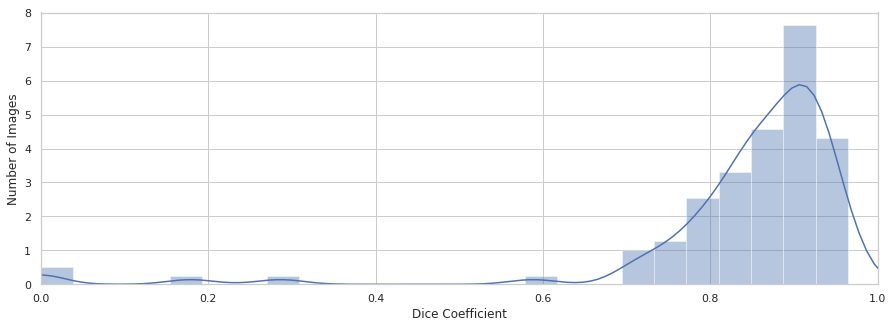

In [59]:
sns.set(style="whitegrid")
plt.figure(figsize=(15,5))
ax = sns.distplot(model1_DCs)
ax.set(xlabel='Dice Coefficient', ylabel='Number of Images')
ax.set_xlim(0, 1.0)

#### Model0 vs Model0b vs Model1

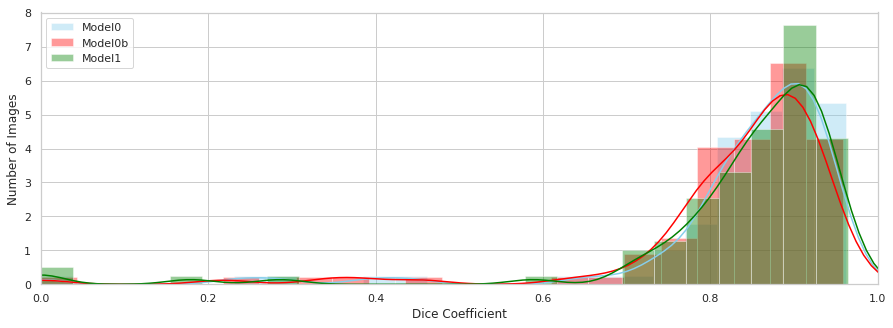

In [58]:
sns.set(style="whitegrid")
plt.figure(figsize=(15,5))
ax = sns.distplot(model0_DCs, color="skyblue", label="Model0")
ax = sns.distplot(model0b_DCs, color="red", label="Model0b")
ax = sns.distplot(model1_DCs, color="green", label="Model1")
ax.set(xlabel='Dice Coefficient', ylabel='Number of Images')
ax.set_xlim(0, 1.0)
ax.legend()

### Root Estimation

#### Tolerance Circle:

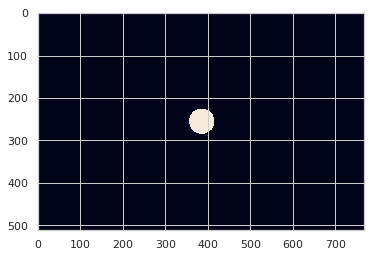

In [ ]:
from skimage.draw import circle
tolerance = 30
img = np.zeros((512, 768), dtype=np.uint8)
rr, cc = circle(512/2, 768/2, tolerance)
img[rr, cc] = 1
imshow(img)

#### Model0:

In [ ]:
model = load_model('../saved_models/model0/model0.h5', custom_objects={'bce_dice_loss': bce_dice_loss,'dice_coeff':dice_coeff,'iou_score':iou_score})

In [ ]:
ev_params = {'df':val20_df,
             'input_shape':(512,768,3),
             'predictiontype':'root',
             'masktype' : 'root',
             'model':model}
ev = Evaluate(**ev_params)

test_log_model0 = ev.log_root_precision_values(tolerance=tolerance)

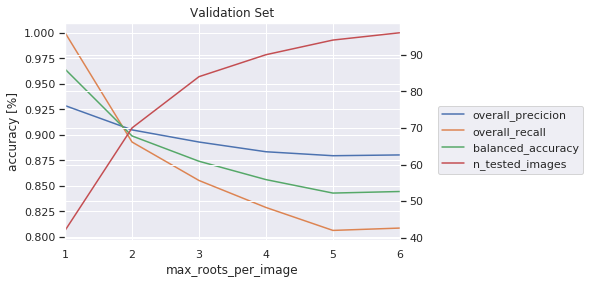

Balanced Accuracy: 0.8443576388888889%


In [49]:
results = {"max_roots_per_image":range(1,len(test_log_model0)+1),
           "true_positive_rate":"pass",
             "overall_precicion":[sum(p[3])/len(p[3]) for p in test_log_model0],
             "overall_recall":[sum(p[4])/len(p[4]) for p in test_log_model0],
             "balanced_accuracy": list((np.asarray([sum(p[3])/len(p[3]) for p in test_log_model0]) + np.asarray([sum(p[4])/len(p[4]) for p in test_log_model0]))/2),
            "n_tested_images":[len(p[0]) for p in test_log_model0]}
test_field_df = pd.DataFrame.from_dict(results)

sns.set(style="darkgrid")
ax = test_field_df[['max_roots_per_image','overall_precicion','overall_recall','balanced_accuracy']].plot(x='max_roots_per_image',legend=False, title='Validation Set')
ax2 = ax.twinx()
ax.set_ylabel("accuracy [%]")
test_field_df[['max_roots_per_image','n_tested_images']].plot(x='max_roots_per_image',y='n_tested_images', ax=ax2, legend=False, color="r")
ax.figure.legend(loc='center left', bbox_to_anchor=(1.0, 0.5))
plt.show()

print("Balanced Accuracy: " + str(results['balanced_accuracy'][-1]) + "%")

#### Model0b:

In [64]:
model = load_model('../saved_models/model0b/model0b.h5', custom_objects={'bce_dice_loss': bce_dice_loss,'dice_coeff':dice_coeff,'iou_score':iou_score})

In [ ]:
ev_params = {'df':val20_df,
             'input_shape':(512,768,3),
             'predictiontype':'root',
             'masktype' : 'root',
             'model':model}
ev = Evaluate(**ev_params)

test_log_model0b = ev.log_root_precision_values(tolerance=tolerance)

In [ ]:
results = {"max_roots_per_image":range(1,len(test_log_model0b)+1),
           "true_positive_rate":"pass",
             "overall_precicion":[sum(p[3])/len(p[3]) for p in test_log_model0b],
             "overall_recall":[sum(p[4])/len(p[4]) for p in test_log_model0b],
             "balanced_accuracy": list((np.asarray([sum(p[3])/len(p[3]) for p in test_log_model0b]) + np.asarray([sum(p[4])/len(p[4]) for p in test_log_model0b]))/2),
            "n_tested_images":[len(p[0]) for p in test_log_model0b]}
test_field_df = pd.DataFrame.from_dict(results)

sns.set(style="darkgrid")
ax = test_field_df[['max_roots_per_image','overall_precicion','overall_recall','balanced_accuracy']].plot(x='max_roots_per_image',legend=False, title='Validation Set')
ax2 = ax.twinx()
ax.set_ylabel("accuracy [%]")
test_field_df[['max_roots_per_image','n_tested_images']].plot(x='max_roots_per_image',y='n_tested_images', ax=ax2, legend=False, color="r")
ax.figure.legend(loc='center left', bbox_to_anchor=(1.0, 0.5))
plt.show()

print("Balanced Accuracy: " + str(results['balanced_accuracy'][-1]) + "%")

#### Model2:

In [ ]:
model = load_model('../saved_models/model2/model2.h5', custom_objects={'bce_dice_loss': bce_dice_loss,'dice_coeff':dice_coeff,'iou_score':iou_score})

In [ ]:
ev_params = {'df':val20_df,
             'input_shape':(512,768,3),
             'predictiontype':'root',
             'masktype' : 'root',
             'model':model}
ev = Evaluate(**ev_params)

test_log_model2 = ev.log_root_precision_values(tolerance=tolerance)

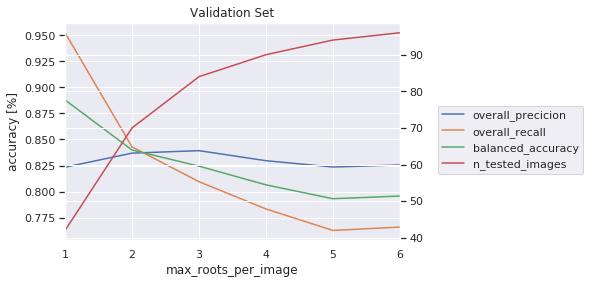

Balanced Accuracy: 0.7957465277777779%


In [50]:
results = {"max_roots_per_image":range(1,len(test_log_model2)+1),
           "true_positive_rate":"pass",
             "overall_precicion":[sum(p[3])/len(p[3]) for p in test_log_model2],
             "overall_recall":[sum(p[4])/len(p[4]) for p in test_log_model2],
             "balanced_accuracy": list((np.asarray([sum(p[3])/len(p[3]) for p in test_log_model2]) + np.asarray([sum(p[4])/len(p[4]) for p in test_log_model2]))/2),
            "n_tested_images":[len(p[0]) for p in test_log_model2]}
test_field_df = pd.DataFrame.from_dict(results)

sns.set(style="darkgrid")
ax = test_field_df[['max_roots_per_image','overall_precicion','overall_recall','balanced_accuracy']].plot(x='max_roots_per_image',legend=False, title='Validation Set')
ax2 = ax.twinx()
ax.set_ylabel("accuracy [%]")
test_field_df[['max_roots_per_image','n_tested_images']].plot(x='max_roots_per_image',y='n_tested_images', ax=ax2, legend=False, color="r")
ax.figure.legend(loc='center left', bbox_to_anchor=(1.0, 0.5))
plt.show()

print("Balanced Accuracy: " + str(results['balanced_accuracy'][-1]) + "%")